# イジング模型：統計物理、情報、AIの架け橋

## ■　はじめに
磁性体の磁性は、物質を構成する原子が持つ電子スピンなどの磁気モーメントに由来します。強磁性体の場合、外部磁場をかけなくても、互いに相互作用することでスピンの向きが揃い磁化を持ちます（磁石として振る舞う）。一方、温度を上げていき相転移点（キュリー温度）を超えると、磁化はなくなります。このような相転移のメカニズムを極限まで単純化したモデルがイジング模型です。

## ■　イジングスピン

イジング模型では、+1と-1の２つのスピン状態をとるイジングスピンから構成されます。
$$
 \sigma _i  \in \{ +1, -1\}
$$
量子力学で登場するスピン1/2（パウリ演算子）は、軸を決めたときに固有値+1,-1をとりますが、軸の選び方は、実空間の好きな方向を選ぶことができるので、+1状態と-1状態の重ね合わせ状態（量子ビット）を取ることができます。しかし、イジングスピンは、量子力学的な重ね合わせ状態は考慮せず、与えられた軸に対してどちらの向きを向いているか、という古典的な２状態のみを考えています。（それゆえ古典情報処理との相性も良いです）

## ■　イジングハミルトニアン

イジング模型のエネルギーは、このイジングスピン同士の相互作用や、外部磁場によって以下に与えられます：
$$
  H = \sum _{(i,j)} J_{i,j} \sigma _i \sigma _j + \sum _i h_i \sigma _i.
$$
$J_{ij}$は２つのスピン$(i,j)$の相互作用の結合強度と呼ばれ、$J_{ij} < 0$の場合には強磁性、$J_{ij} <0$の場合には反強磁性の相互作用に対応します。また、$h_i$は$i$番目のスピンに作用する磁場に対応します。上記では一般的なモデルとして、結合強度や磁場がサイトに依存する形で定義されていますが、$J_{ij} = -J < 0, \; h_i=0$のように、均一なモデルとする場合もあります。また、$\sum_{(i,j)}$については、相互作用するすべてのスピンのペアに関する和を意味します。正方格子上で定義されるイジング模型の場合は、正方格子の頂点にイジングスピンを配置し、相互作用はその辺に対応します。

## ■　熱平衡状態

熱平衡状態にあるとき、あるスピン配位の状態${\bm \sigma} = (\sigma _1, \sigma_2,...., \sigma _n)$がどれくらいの出現確率で得られるかは逆温度 $\beta = 1/T$ （ボルツマン定数は1とした）を用いてボルツマン分布、
$$
P({\bm \sigma}) = \exp[- \beta H({\bm \sigma})]/Z
$$
で与えられます。ここで、$Z$は規格化因子であり、ボルツマン因子をすべての配位について足したものであり、分配関数と呼ばれます：
$$
Z= \sum_{{\bm \sigma}} \exp[- \beta H({\bm \sigma})]
$$
ボルツマン分布は、エネルギーが低い状態ほど、逆温度$\beta$が多いきければ（温度が低ければ）、高頻度で出現するという分布になっています。

## ■　イジングハミルトニアンの例
２サイトからなる簡単例をみてみましょう。ハミルトニアンは、$J,h$を正の定数として、
$$
H= -J \sigma _1 \sigma _2 + h \sigma _1 + h \sigma _2
$$
とします。スピン配位のパターンは、$(\sigma _1,\sigma _2) = (+1,+1), (+1,-1), (-1,+1), (-1,-1)$の４パターン存在します。それぞれのエネルギーは、$-J+2h, +J, +J, -J-2h$となります。
よって、$(-1,-1)$の状態が最もエネルギーが低い状態となります。それぞれのスピン配位の取る確率を逆温度の関数としてプロットしてみましょう。


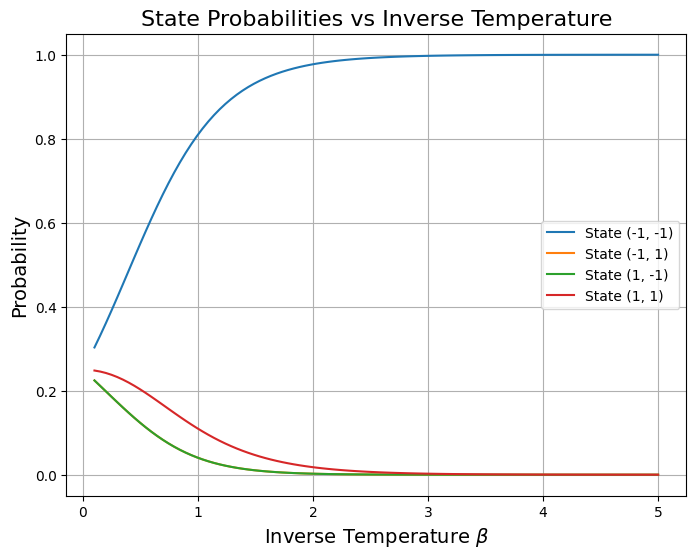

In [20]:
import numpy as np
import matplotlib.pyplot as plt

# パラメータの設定
J = 1.0  # 交換相互作用
h = 0.5  # 外部磁場

# スピン状態
states = [(-1, -1), (-1, 1), (1, -1), (1, 1)]

# 逆温度ベータの範囲
beta_values = np.linspace(0.1, 5, 100)

# 状態のエネルギーを計算する関数
def hamiltonian(sigma1, sigma2, J, h):
    return -J * sigma1 * sigma2 + h * (sigma1 + sigma2)

# 各スピン状態の確率を計算
probabilities = {state: [] for state in states}

for beta in beta_values:
    # 各状態のエネルギーを計算
    energies = np.array([hamiltonian(sigma1, sigma2, J, h) for sigma1, sigma2 in states])
    # 分配関数
    Z = np.sum(np.exp(-beta * energies))
    # 各状態の確率
    for state in states:
        energy = hamiltonian(state[0], state[1], J, h)
        probabilities[state].append(np.exp(-beta * energy) / Z)

# プロット
plt.figure(figsize=(8, 6))
for state, probs in probabilities.items():
    plt.plot(beta_values, probs, label=f"State {state}")

plt.xlabel(r"Inverse Temperature $\beta$", fontsize=14)
plt.ylabel("Probability", fontsize=14)
plt.title("State Probabilities vs Inverse Temperature", fontsize=16)
plt.legend()
plt.grid(True)
plt.show()


## ■　自発的対称性の破れと相転移
上記の例では、磁場$h$の項を考えたため、最もエネルギーが低くなる配位が唯一定まりました。しかし、$h=0$とすると、スピンアップとダウンの状態入れ替えてもハミルトニアンは全く同じ（対称）になっているめ、スピンをフリップした状態は全く同じエネルギーを持つことになります。よって、スピンが上もしくは下に向いた確率は等確率で出現し、この確率分布のもとで磁化の期待値を計算すると磁化は必ず0になります。これを対称性と言います。しかし、実際にはある温度よりも低くなると二次元以上のイジング模型の熱力学極限（システムサイズが大きい極限）を考えると対称性は破れ、自発的に磁化を持ちます。これを対称性の破れによる秩序の形成（向きが揃う）と呼びます。

## ■　モンテカルロ法
実際に大きなサイズの系の分配関数を計算することは難しいので、モンテカルロ法を用いてボルツマン分布に従う確率でスピン配位をサンプルしてみましょう。ここでは、メトロポリス-ヘイスティングス法を用います。
メトロポリス・ヘイスティングス法（Metropolis-Hastings method）は、マルコフ連鎖モンテカルロ法（MCMC）の一つで、特定の確率分布（**目標分布 $ \pi(x) $**）に従ったサンプリングを行う手法です。提案分布**提案分布 $ q(x'|x) $**に基づいて次の候補状態 $ x' $ をサンプリングし、次にこの候補を受け入れるか拒否するかを受理確率$\alpha(x, x') $を用いて確率的に判断します。これを繰り返した極限で、目的分布に収束することが保障されています。

### 3. メトロポリス・ヘイスティングス法のアルゴリズム
メトロポリス・ヘイスティングス法は、次のステップで進行します。

1. **初期状態の設定**：初期状態 $ x_0 $ を任意に設定します。

2. **提案状態のサンプリング**：提案分布 $ q(x'|x) $ を用いて、現在の状態 $ x $ から新しい候補状態 $ x' $ をサンプリングします。

3. **受け入れ率の計算**：候補状態 $ x' $ を受け入れるか拒否するかを、次の**受理確率** $ \alpha(x, x') $ に基づいて判断します：

$$
\alpha(x, x') = \min \left( 1, \frac{\pi(x') q(x|x')}{\pi(x) q(x'|x)} \right)
$$

ここで、
- $ \pi(x) $：目標分布（サンプリングしたい分布）
- $ q(x'|x) $：現在の状態 $x $ から次の状態 $x' $ への遷移を提案する提案分布

受理確率 $\alpha(x, x') $ は次の遷移先である $x' $ が現在の状態 $x $ よりも目標分布において適切であるかを判断するために用いられます。もし $\pi(x') $ が $\pi(x) $ よりも高ければ、$x' $ を必ず受け入れます（すなわち、受理確率は1になります）。逆に、$\pi(x') $ が小さければ、確率的に $x' $ を受け入れるかどうかを判断します。

4. **状態の更新**：ランダムに生成した確率 $u \in [0, 1] $ を使って、以下の決定を行います：
- $u \leq \alpha(x, x') $ の場合、$x' $ を受け入れます（新しい状態に遷移する）。
- $u > \alpha(x, x') $ の場合、$x $ のまま状態を維持します。

5. **繰り返し**：このプロセスを繰り返し、目標分布 $\pi(x) $ に従ったサンプルを多数生成します。一定のステップ数を経た後、サンプルは目標分布に従っているとみなせます。

### 4. メトロポリス法
**メトロポリス法**は、提案分布 $q(x'|x) $ が対称（すなわち、$q(x'|x) = q(x|x') $）であるという仮定を持ちます。この場合、受け入れ率は次のように簡略化されます：

$$
\alpha(x, x') = \min \left( 1, \frac{\pi(x')}{\pi(x)} \right)
$$

一方、**メトロポリス・ヘイスティングス法**は、提案分布が対称でない場合でも適用できる一般的な手法です。非対称な提案分布を用いた場合、受け入れ率に提案分布の比 $\frac{q(x|x')}{q(x'|x)} $ が追加されます。

このように、メトロポリス・ヘイスティングス法は、提案分布からサンプルを生成し、その候補状態をボルツマン分布やベイズ推定の事後分布のような目標分布に従うように確率的に受け入れるかどうかを判断するアルゴリズムです。この手法により、複雑な確率分布のサンプリングが効率的に行えるようになります。

### 5. ボルツマン分布の場合
ボルツマン分布の場合は、上記の議論での目標分布$\pi(x)$が、
$$
P({\bf \sigma}) = e^{-\beta H({\bm \sigma})}/Z
$$
であり、$x'$は１つだけランダムにスピンを選び、そのスピンを反転させるような場合を考えます。この時、提案分布が対象になり、メトロポリス法として扱えます。また、受理確率は、
$$
\frac{\pi(x')}{\pi(x)}  \rightarrow \frac{P({\bm \sigma}')}{P({\bm \sigma})} = e^{-\beta [H({\bm \sigma}')- H({\bm \sigma})]}=e^{-\beta \Delta E}
$$
となり、エンエルギーが減少（$\Delta E <0$）した場合は確率1で受理、増加した場合は、確率$e^{-\beta \Delta E}$で受理するアルゴリズムになっています。（分配関数$Z$の計算は計算コストがかかってできませんが、分母分子で打ち消されるので、受理確率は簡単に計算できると言う点に注意しましょう）。




## ■　二次元イジング模型のモンテカルロシミュレーション

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Jupyter用のアニメーション設定
%matplotlib inline

# 格子のサイズ
L = 50

# スピン格子の初期化 (+1で揃える)
def initialize_lattice(L):
    return np.random.choice([-1, 1], size=(L, L))

# エネルギー計算
def calculate_energy(lattice, i, j):
    return lattice[i, j] * (
        lattice[(i+1)%L, j] + lattice[(i-1)%L, j] + lattice[i, (j+1)%L] + lattice[i, (j-1)%L]
    )

# 磁化の計算
def calculate_magnetization(lattice):
    return np.sum(lattice)/(L*L)

# モンテカルロステップ (1 温度あたり全サイトを1回試行)
def monte_carlo_step(lattice, T):
    for _ in range(L**2):
        i, j = np.random.randint(0, L), np.random.randint(0, L)
        dE = 2 * calculate_energy(lattice, i, j)
        if dE <= 0 or np.random.random() < np.exp(-dE / T):
            lattice[i, j] *= -1  # スピン反転

# アニメーションの準備
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

# スピン配置のアニメーション用
lattice = initialize_lattice(L)
im = ax1.imshow(lattice, cmap='coolwarm')
ax1.set_title("Spin Configuration")

# 磁化のグラフの準備
magnetizations = []
temps = []
steps = []

line, = ax2.plot([], [], lw=2)
ax2.set_xlim(0, 200)
ax2.set_ylim(-2, 2)
ax2.set_xlabel('Monte Carlo Step')
ax2.set_ylabel('Magnetization')

# アニメーションの更新関数
def update(frame):
    global lattice
    T = max(0.1, 4.0 - 0.02 * frame)  # 高温4.0から低温0.1まで徐々に冷却
    for _ in range(30):
        monte_carlo_step(lattice, T)
    
    # スピン配置の更新
    im.set_array(lattice)
    
    # 磁化の計算とプロットデータの更新
    magnetization = calculate_magnetization(lattice)
    magnetizations.append(magnetization)
    temps.append(T)
    steps.append(frame)
    
    # 磁化のグラフを更新
    line.set_data(steps, magnetizations)
    ax2.set_title(f"Temperature: {T:.2f}, Magnetization: {magnetization:.2f}")
    
    return [im, line]

# アニメーションの作成
ani = animation.FuncAnimation(fig, update, frames=200, interval=100, blit=True)

# Jupyter Notebook上でアニメーションを表示
plt.close(fig)  # 不要な静止画の表示を防ぐ
HTML(ani.to_jshtml())


反強磁性相互作用にするとどうなるでしょうか。。。。

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Jupyter用のアニメーション設定
%matplotlib inline

# 格子のサイズ
L = 50

# スピン格子の初期化 (+1で揃える)
def initialize_lattice(L):
    return np.random.choice([-1, 1], size=(L, L))

# エネルギー計算
def calculate_energy(lattice, i, j):
    # anti ferromagnetic interaction
    return - lattice[i, j] * (
        lattice[(i+1)%L, j] + lattice[(i-1)%L, j] + lattice[i, (j+1)%L] + lattice[i, (j-1)%L]
    )

# 磁化の計算（市松模様に磁化を評価するように修正）
def calculate_magnetization(lattice):
    L = lattice.shape[0]  # 格子のサイズ
    magnetization = 0
    for i in range(L):
        for j in range(L):
            magnetization += lattice[i, j] * (-1)**(i + j)
    return magnetization / (L * L)


# モンテカルロステップ (1 温度あたり全サイトを1回試行)
def monte_carlo_step(lattice, T):
    for _ in range(L**2):
        i, j = np.random.randint(0, L), np.random.randint(0, L)
        dE = 2 * calculate_energy(lattice, i, j)
        if dE <= 0 or np.random.random() < np.exp(-dE / T):
            lattice[i, j] *= -1  # スピン反転

# アニメーションの準備
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

# スピン配置のアニメーション用
lattice = initialize_lattice(L)
im = ax1.imshow(lattice, cmap='coolwarm')
ax1.set_title("Spin Configuration")

# 磁化のグラフの準備
magnetizations = []
temps = []
steps = []

line, = ax2.plot([], [], lw=2)
ax2.set_xlim(0, 200)
ax2.set_ylim(-2, 2)
ax2.set_xlabel('Monte Carlo Step')
ax2.set_ylabel('Magnetization')

# アニメーションの更新関数
def update(frame):
    global lattice
    T = max(0.1, 4.0 - 0.02 * frame)  # 高温4.0から低温0.1まで徐々に冷却
    for _ in range(30):
        monte_carlo_step(lattice, T)
    
    # スピン配置の更新
    im.set_array(lattice)
    
    # 磁化の計算とプロットデータの更新
    magnetization = calculate_magnetization(lattice)
    magnetizations.append(magnetization)
    temps.append(T)
    steps.append(frame)
    
    # 磁化のグラフを更新
    line.set_data(steps, magnetizations)
    ax2.set_title(f"Temperature: {T:.2f}, Magnetization: {magnetization:.2f}")
    
    return [im, line]

# アニメーションの作成
ani = animation.FuncAnimation(fig, update, frames=200, interval=100, blit=True)

# Jupyter Notebook上でアニメーションを表示
plt.close(fig)  # 不要な静止画の表示を防ぐ
HTML(ani.to_jshtml())


イジング相互作用をうまく設定することで、パターンを低エネルギー状態のスピン配位に記憶させることができるようです。

## ■ ホップフィールドモデル
2024年にノーベル物理学賞を受賞した、ジョン・ホップフィールドによるホップフィールドモデルは、まさにイジング模型に情報を記憶させ、外部入力から記憶させた情報を想起させるというモデルになっています。

ホップフィールドモデルは、自己結合型の再帰神経ネットワークであり、記憶したいパターンをエネルギー極小点として保存します。ニューロンの状態としてイジングスピン $\sigma_i \in \{-1, +1\}$を、それらの結合として重み $W_{ij}$ としてどのようにして情報を記憶するかを説明していきます。上記のイジング模型では、正方格子の再近接相互作用でしたが、ここでは全結合のニューロンを考えます。

### 学習の仕組み（ヘッブの学習則）

ホップフィールドモデルでは、記憶したいパターンを用いて重み行列 $W_{ij}$ を設定します。$P$ 個のパターン $\{\xi_i^\mu\}$（$\mu = 1, 2, \dots, P$）を記憶させたい場合、重みは以下のヘッブの学習則に従って計算されます。

$$
W_{ij} = \frac{1}{N} \sum_{\mu=1}^{P} \xi_i^\mu \xi_j^\mu \quad (i \neq j)
$$

- $N$：ニューロン（以下、ニューロンとイジングスピンを同じ意味で使用します）の総数
- $\xi_i^\mu$：パターン $\mu$ におけるニューロン $i$ の状態（$\xi_i^\mu \in \{-1, +1\}$）

**対角成分はゼロに設定します：**

$$
W_{ii} = 0
$$

- **重みの設定**：重み $W_{ij}$ は、記憶したい全パターンにおけるニューロン $i$ と $j$ の状態の積を合計し、$N$ で正規化したものです。これは、同じ状態を持つニューロン間の結合を強化（強磁性）し、異なる状態を持つ場合は抑制する（反強磁性）効果があります。
- **自己結合の除外**：$W_{ii} = 0$ とすることで、ニューロン自身へのフィードバックを防ぎます。

### エネルギーの定義と状態更新の方法

ネットワークの状態は、エネルギー関数を最小化する方向に更新されます。エネルギー関数は以下のように定義されます。

$$
E = -\frac{1}{2} \sum_{i=1}^{N} \sum_{j=1}^{N} W_{ij} \sigma_i \sigma_j
$$

- $\sigma_i$：ニューロン $i$ の状態（$\sigma_i \in \{-1, +1\}$）

エネルギー $E$ は、ネットワークの全体的な「不安定さ」を表し、状態更新によってエネルギーを減少させることが目標となります。


ホップフィールドモデルでは、一つ過去のニューロンの状態を用いて、次のニューロンの状態をを以下の規則に従って更新されます。

1. **局所場（入力）の計算**

   $$
   h_i = \sum_{j=1}^{N} W_{ij} \sigma_j
   $$

   - $h_i$：ニューロン $i$ の局所場（総入力）

2. **状態の更新**

   $$
   \sigma_i^{\text{new}} = \text{sgn}(h_i)
   $$

   - $\text{sgn}(h)$：符号関数

     $$
     \text{sgn}(h) = \begin{cases}
     +1 & (h > 0) \\
     -1 & (h < 0) \\
     \sigma_i^{\text{old}} & (h = 0)
     \end{cases}
     $$

- **局所場の役割**：$h_i$ は、ニューロン $i$ が他のニューロンから受け取る影響の総和です。これにより、ニューロンは周囲の状態に応じて自分の状態を更新します。
- **状態の決定**：符号関数により、局所場が正であれば $\sigma_i = +1$、負であれば $\sigma_i = -1$ に更新されます。局所場がゼロの場合は、状態を変化させないか、ランダムに決定します。

### エネルギーの変化

状態更新によるエネルギーの変化は以下で表されます。

$$
\Delta E = -\sum_{i=1}^{N} \Delta \sigma_i h_i
$$

- $\Delta \sigma_i = \sigma_i^{\text{new}} - \sigma_i^{\text{old}}$

非同期更新（一度に一つのニューロンのみを更新）を採用すると、エネルギーは単調に減少します。


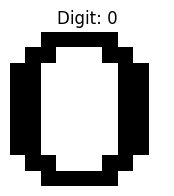

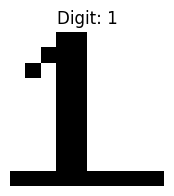

In [72]:
import matplotlib.pyplot as plt
import numpy as np

# 数字のピクセルデータを定義
digits = {
    0: np.array([
        [0,0,1,1,1,1,1,0,0,0],
        [0,1,1,0,0,0,1,1,0,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,1,1,0,0,0,1,1,0,0],
        [0,0,1,1,1,1,1,0,0,0]
    ]),
    1: np.array([
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,1,1,1,0,0,0,0,0],
        [0,1,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [1,1,1,1,1,1,1,1,1,1]
    ]),
    # 以下、2から9までの数字データも同様に定義します
    # ...
}

# 数字を表示する関数
def show_digit(digit):
    plt.figure(figsize=(2, 2))  
    plt.imshow(digits[digit], cmap='Greys')
    plt.title(f'Digit: {digit}')
    plt.axis('off')
    plt.show()

# 0から9までの数字を順番に表示
for i in range(2):
    show_digit(i)


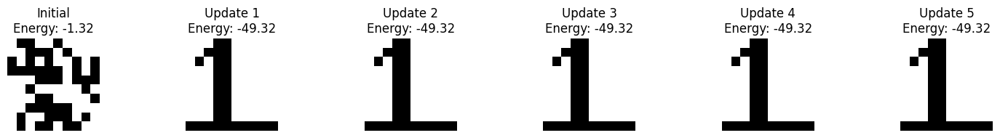

In [73]:
import numpy as np
import matplotlib.pyplot as plt

# 数字のピクセルデータを定義（digits辞書は既に定義されているものとします）
# 前回のコードからdigits辞書をそのまま使用してください

# パターンを準備（0と1を-1と1に変換し、ベクトル化）
patterns = []
for i in range(2):
    pattern = digits[i]
    pattern = pattern * 2 - 1  # 0と1を-1と1に変換
    patterns.append(pattern.flatten())

# 重み行列を計算（ヘッブの学習則）
def train_hopfield(patterns):
    n = patterns[0].size
    W = np.zeros((n, n))
    for p in patterns:
        W += np.outer(p, p)
    np.fill_diagonal(W, 0)  # 対角成分は0に設定
    return W / n

# ホップフィールドモデルの更新規則（同期）
def update(state, W):
    return np.sign(W @ state)

# ホップフィールドモデルの更新規則（非同期）
#def update(state, W):
#    n = len(state)
#    indices = np.random.permutation(n)
#    for i in indices:
#        h_i = W[i] @ state
#        state[i] = 1 if h_i >= 0 else -1
#    return state



# エネルギー関数を計算
def energy(state, W):
    return -0.5 * state @ W @ state

# ノイズを加える関数
def add_noise(pattern, noise_level):
    noisy_pattern = pattern.copy()
    n_flip = int(noise_level * len(pattern))
    flip_indices = np.random.choice(len(pattern), n_flip, replace=False)
    noisy_pattern[flip_indices] *= -1
    return noisy_pattern

# 学習
W = train_hopfield(patterns)

# テスト用の数字
test_digit = 1
original_pattern = patterns[test_digit]

# ノイズを加える
noise_level = 0.4  # ノイズレベル
noisy_pattern = add_noise(original_pattern, noise_level)

# 更新過程を観察
state = noisy_pattern.copy()
states = [state.reshape(10, 10)]
energies = [energy(state, W)]

for _ in range(5):
    state = update(state, W)
    states.append(state.reshape(10, 10))
    energies.append(energy(state, W))

# 結果を表示
fig, axes = plt.subplots(1, len(states), figsize=(15, 2))
titles = [f'Initial\nEnergy: {energies[0]:.2f}'] + [f'Update {i}\nEnergy: {energies[i]:.2f}' for i in range(1, len(states))]
for ax, state_img, title in zip(axes, states, titles):
    ax.imshow(state_img, cmap='Greys')
    ax.set_title(title)
    ax.axis('off')
plt.tight_layout()
plt.show()


他の数字のピクセルデータも置いておきます。

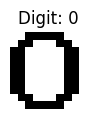

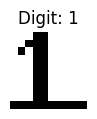

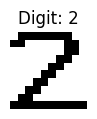

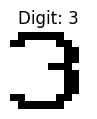

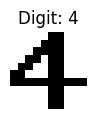

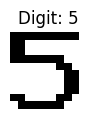

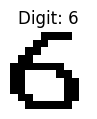

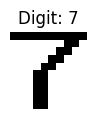

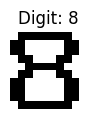

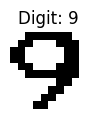

In [71]:
import matplotlib.pyplot as plt
import numpy as np

# 数字のピクセルデータを定義
digits = {
    0: np.array([
        [0,0,1,1,1,1,1,0,0,0],
        [0,1,1,0,0,0,1,1,0,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,1,1,0,0,0,1,1,0,0],
        [0,0,1,1,1,1,1,0,0,0]
    ]),
    1: np.array([
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,1,1,1,0,0,0,0,0],
        [0,1,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [1,1,1,1,1,1,1,1,1,1]
    ]),
    2: np.array([
        [0,1,1,1,1,1,1,1,0,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,1,1,0,0],
        [0,0,0,0,0,1,1,0,0,0],
        [0,0,0,0,1,1,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,1,1,0,0,0,0,0,0],
        [0,1,1,0,0,0,0,0,0,0],
        [1,1,1,1,1,1,1,1,1,1]
    ]),
    3: np.array([
        [0,1,1,1,1,1,1,0,0,0],
        [1,1,0,0,0,0,1,1,0,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,1,1,1,0,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,1,1,0,0],
        [0,1,1,1,1,1,1,0,0,0]
    ]),
    4: np.array([
        [0,0,0,0,0,1,1,0,0,0],
        [0,0,0,0,1,1,1,0,0,0],
        [0,0,0,1,1,1,1,0,0,0],
        [0,0,1,1,0,1,1,0,0,0],
        [0,1,1,0,0,1,1,0,0,0],
        [1,1,0,0,0,1,1,0,0,0],
        [1,1,1,1,1,1,1,1,1,1],
        [0,0,0,0,0,1,1,0,0,0],
        [0,0,0,0,0,1,1,0,0,0],
        [0,0,0,0,0,1,1,0,0,0]
    ]),
    5: np.array([
        [1,1,1,1,1,1,1,1,1,0],
        [1,1,0,0,0,0,0,0,0,0],
        [1,1,0,0,0,0,0,0,0,0],
        [1,1,1,1,1,1,1,0,0,0],
        [0,0,0,0,0,0,1,1,0,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,1,1,0,0],
        [0,1,1,1,1,1,1,0,0,0]
    ]),
    6: np.array([
        [0,0,0,0,1,1,1,1,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,1,1,0,0,0,0,0,0],
        [0,1,1,0,0,0,0,0,0,0],
        [1,1,1,1,1,1,1,0,0,0],
        [1,1,0,0,0,0,1,1,0,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,1,1,0,0,0,0,1,1,0],
        [0,0,1,1,1,1,1,1,0,0]
    ]),
    7: np.array([
        [1,1,1,1,1,1,1,1,1,1],
        [0,0,0,0,0,0,0,1,1,0],
        [0,0,0,0,0,0,1,1,0,0],
        [0,0,0,0,0,1,1,0,0,0],
        [0,0,0,0,1,1,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0]
    ]),
    8: np.array([
        [0,1,1,1,1,1,1,1,0,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,1,1,0,0,0,1,1,0,0],
        [0,0,1,1,1,1,1,0,0,0],
        [0,1,1,0,0,0,1,1,0,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,1,1,1,1,1,1,1,0,0]
    ]),
    9: np.array([
        [0,0,1,1,1,1,1,1,0,0],
        [0,1,1,0,0,0,1,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [1,1,0,0,0,0,0,1,1,0],
        [0,1,1,0,0,0,1,1,1,0],
        [0,0,1,1,1,1,1,1,1,0],
        [0,0,0,0,0,0,1,1,0,0],
        [0,0,0,0,0,1,1,0,0,0],
        [0,0,0,0,1,1,0,0,0,0],
        [0,0,0,1,1,0,0,0,0,0]
    ])
}

# 数字を表示する関数
def show_digit(digit):
    plt.figure(figsize=(1, 1))
    plt.imshow(digits[digit], cmap='Greys')
    plt.title(f'Digit: {digit}')
    plt.axis('off')
    plt.show()

# 0から9までの数字を順番に表示
for i in range(10):
    show_digit(i)


ホップフィールドモデルが安定的に記憶するためには、エネエルギーが準安定となる配位が干渉せずに配置される必要があります。このため、記憶できるパターン数や、許容できるノイズには限界があります。このような限界はスピングラス理論と呼ばれるランダム性を持ったイジング模型を扱う統計力学の手法によって解析をすることができます。ニューロンの数（スピンの数）$N$に対して、記憶できるパターン数の理論的上限値は、約$0.14N$となることが知られています（安定的に取り出すためには、$0.05N$）。これよりも多くのパターンを埋め込むと、スピングラス相になり全く記憶させたデータとは異なるデタラメなパターンを想起してしまうようになります。

### 本日の課題
(1) 上記の数字のうち２つの数字を選び、２つの状態を記憶されるホップフィールドニューラルネットワークを実装してください。

(2) 記憶させるパターンを増やした場合に、もしは、入力のデータのノイズレベルを上げた場合に正く想起される確率（正解率）はどのようになるか調べてください。

## ■ ボルツマン機械学習

ホップフィールドニューラルネットワークは、シンプルなモデルなので、表現できる情報（記憶できる情報）には限界があります。また、想起のメカニズムも決定論的な更新ルールになっているため、より広く状態空間を探索することができません。これらの問題を解決するのがボルツマンマシンです。特に、入力データを扱う可視ユニットに加えて、表現能力を向上させるための内部状態として、隠れユニットを持っています。この隠れユニットに入力データの特徴が格納されることになります（特徴量学習）。これが、後のディープニューラルネットワークへと発展をしていきました。

ボルツマンマシン（Boltzmann Machine）は、統計力学の原理を応用した確率的な再帰型ニューラルネットワークであり、データの複雑な確率分布を学習することができます。デープニューラルネットワークで有名なジェフェリー・ヒントンは、テリー・セジュノスキーとともに1985年にボルツマンマシンを開発し、2024年にノーベル物理学賞を受賞しました。

### ボルツマンマシンの構造

ボルツマンマシンは、**可視ユニット**（$\mathbf{v}$）と**隠れユニット**（$\mathbf{h}$）からなるノードの集合で構成され、これらのノード間には対称的な双方向の結合（重み）が存在します。

- $\mathbf{v} = (v_1, v_2, \dots, v_{n_v})$：可視ユニット（観測データに対応）
- $\mathbf{h} = (h_1, h_2, \dots, h_{n_h})$：隠れユニット（潜在変数）

各ユニットは二値の状態を取り、$v_i, h_j \in \{0, 1\}$です。（これまではイジングスピンとして、$\pm1$の値を持っていましたが、以降では0,1の2値変数を使います。）

### エネルギー関数

ボルツマンマシンのエネルギー関数は、ネットワークの状態（$\mathbf{v}, \mathbf{h}$）に対して以下のように定義されます。

$$
E(\mathbf{v}, \mathbf{h}) = -\sum_{i}\sum_{j}v_i W_{ij} h_j - \sum_{i} b_i v_i - \sum_{j} c_j h_j
$$

- $W_{ij}$：可視ユニット$i$と隠れユニット$j$間の重み
- $b_i$：可視ユニット$i$のバイアス
- $c_j$：隠れユニット$j$のバイアス

エネルギー関数は、システムの状態の「良さ」を表し、低エネルギーの状態ほど出現確率が高くなります。

### 確率分布

ボルツマンマシンは、エネルギー関数を用いてシステムの状態の同時確率分布を定義します。

$$
P(\mathbf{v}, \mathbf{h}) = \frac{1}{Z} \exp\left(-E(\mathbf{v}, \mathbf{h})\right)
$$

- $Z$：分配関数（正規化定数）

$$
Z = \sum_{\mathbf{v}, \mathbf{h}} \exp\left(-E(\mathbf{v}, \mathbf{h})\right)
$$

可視ユニットの周辺確率分布は、隠れユニットについて総和をとることで得られます。

$$
P(\mathbf{v}) = \sum_{\mathbf{h}} P(\mathbf{v}, \mathbf{h})
$$

### 制限ボルツマンマシン（RBM）

計算の複雑さを軽減するために、ボルツマンマシンの特別なケースである **制限ボルツマンマシン（Restricted Boltzmann Machine, RBM）** がよく使用されます。RBMでは、可視ユニット同士、隠れユニット同士の間に結合がなく、可視層と隠れ層間のみで結合されています。

この制約により、可視ユニットと隠れユニット間の条件付き確率分布が以下のように単純化されます。

- **可視ユニットの条件付き分布**

$$
P(v_i = 1 \mid \mathbf{h}) = \sigma\left(b_i + \sum_{j} W_{ij} h_j\right)
$$

- **隠れユニットの条件付き分布**

$$
P(h_j = 1 \mid \mathbf{v}) = \sigma\left(c_j + \sum_{i} W_{ij} v_i\right)
$$

ここで、$\sigma(x)$はシグモイド関数です。

$$
\sigma(x) = \frac{1}{1 + \exp(-x)}
$$

### 学習アルゴリズム

#### 対数尤度の最大化

RBMの学習は、データの対数尤度を最大化することに相当します。データセット$\mathcal{D}$に対して、パラメータ$\theta = \{W, b, c\}$を最適化します。

目的関数：

$$
\mathcal{L} = \sum_{\mathbf{v} \in \mathcal{D}} \log P(\mathbf{v})
$$

#### 勾配の計算

対数尤度の勾配は以下のようになります。

$$
\frac{\partial \mathcal{L}}{\partial W_{ij}} = \langle v_i h_j \rangle_{\text{data}} - \langle v_i h_j \rangle_{\text{model}}
$$

$$
\frac{\partial \mathcal{L}}{\partial b_i} = \langle v_i \rangle_{\text{data}} - \langle v_i \rangle_{\text{model}}
$$

$$
\frac{\partial \mathcal{L}}{\partial c_j} = \langle h_j \rangle_{\text{data}} - \langle h_j \rangle_{\text{model}}
$$

- $\langle \cdot \rangle_{\text{data}}$：データによる期待値
- $\langle \cdot \rangle_{\text{model}}$：モデルによる期待値

#### コントラスト・ダイバージェンス（Contrastive Divergence, CD）

モデルによる期待値$\langle \cdot \rangle_{\text{model}}$の計算は計算量が膨大であるため、近似的な方法である **コントラスト・ダイバージェンス（CD）** が用いられます。


1. **正方向パス**：
   - データ$\mathbf{v}^{(0)}$から開始し、隠れユニットの状態をサンプリング。

$$
P(h_j = 1 \mid \mathbf{v}^{(0)}) = \sigma\left(c_j + \sum_{i} W_{ij} v_i^{(0)}\right)
$$

2. **逆方向パス**：
   - サンプリングした$\mathbf{h}^{(0)}$から可視ユニットを再サンプリングして$\mathbf{v}^{(1)}$を得る。

$$
P(v_i^{(1)} = 1 \mid \mathbf{h}^{(0)}) = \sigma\left(b_i + \sum_{j} W_{ij} h_j^{(0)}\right)
$$

3. **再度隠れユニットをサンプリング**：
   - $\mathbf{v}^{(1)}$から$\mathbf{h}^{(1)}$をサンプリング。

$$
P(h_j^{(1)} = 1 \mid \mathbf{v}^{(1)}) = \sigma\left(c_j + \sum_{i} W_{ij} v_i^{(1)}\right)
$$

4. **パラメータの更新**：

$$
\Delta W_{ij} = \eta \left( \langle v_i^{(0)} h_j^{(0)} \rangle - \langle v_i^{(1)} h_j^{(1)} \rangle \right)
$$

$$
\Delta b_i = \eta \left( v_i^{(0)} - v_i^{(1)} \right)
$$

$$
\Delta c_j = \eta \left( h_j^{(0)} - h_j^{(1)} \right)
$$

- $\eta$：学習率

コントラスト・ダイバージェンスでは、上述の手順を$k$回繰り返すこともできます（これを **CD-$k$** と呼びます）。$k$が大きいほどモデルの期待値に近づきますが、計算コストも増加します。一般的には$k=1$または$k=2$が用いられます。

### 学習の流れ

1. **初期化**：重み$W$とバイアス$b$, $c$を小さな値でランダムに初期化。
2. **データの入力**：可視ユニットにデータ$\mathbf{v}^{(0)}$を与える。
3. **隠れユニットのサンプリング**：$P(\mathbf{h} \mid \mathbf{v}^{(0)})$から$\mathbf{h}^{(0)}$をサンプリング。
4. **可視ユニットの再サンプリング**：$P(\mathbf{v} \mid \mathbf{h}^{(0)})$から$\mathbf{v}^{(1)}$をサンプリング。
5. **隠れユニットの再サンプリング**：$P(\mathbf{h} \mid \mathbf{v}^{(1)})$から$\mathbf{h}^{(1)}$をサンプリング。
6. **パラメータの更新**：$\Delta W_{ij}, \Delta b_i, \Delta c_j$を計算し、パラメータを更新。
7. **繰り返し**：エポック数または収束条件に達するまで2〜6の手順を繰り返す。



In [78]:
!pip install torch
!pip install torchvision
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torchvision import datasets, transforms


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: pip install --upgrade pip
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 7.5 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: pip install --upgrade pip


MNISTデータセットをダウンロードし、データローダーを作成します。RBMは二値データを扱うため、ピクセル値を0か1に二値化します。

In [93]:
# ハイパーパラメータ（後ほど使用するため、先に定義します）
visible_units = 28 * 28  # 784
hidden_units = 64       # 隠れユニットの数
batch_size = 64
epochs = 5
k = 1  # CD-kのk
learning_rate = 0.1

# データの変換（テンソル化と二値化）
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Lambda(lambda x: torch.bernoulli(x))  # ピクセル値を0か1に二値化
])

# 訓練データのダウンロードとデータローダーの作成
mnist_data = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
data_loader = torch.utils.data.DataLoader(mnist_data, batch_size=batch_size, shuffle=True)

RBMクラスは、可視ユニットの数を784に設定します。

In [95]:
class RBM(nn.Module):
    def __init__(self, visible_units, hidden_units):
        super(RBM, self).__init__()
        self.visible_units = visible_units
        self.hidden_units = hidden_units
        
        # 重みとバイアスの初期化
        self.W = nn.Parameter(torch.randn(visible_units, hidden_units) * 0.01)
        self.v_bias = nn.Parameter(torch.zeros(visible_units))
        self.h_bias = nn.Parameter(torch.zeros(hidden_units))
        
    # 隠れ層のユニットをサンプリング
    def sample_h(self, v):
        h_prob = torch.sigmoid(torch.matmul(v, self.W) + self.h_bias)
        return h_prob, torch.bernoulli(h_prob)
    
    # 可視層のユニットをサンプリング
    def sample_v(self, h):
        v_prob = torch.sigmoid(torch.matmul(h, self.W.t()) + self.v_bias)
        return v_prob, torch.bernoulli(v_prob)
    
    # コントラスト・ダイバージェンス法による重みの更新
    def contrastive_divergence(self, v0, k=1):
        vk = v0
        for _ in range(k):
            h_prob, h = self.sample_h(vk)
            v_prob, vk = self.sample_v(h)
        return v0, vk.detach()
    
    # 重みの更新
    def forward(self, v0, vk):
        h0_prob, _ = self.sample_h(v0)
        hk_prob, _ = self.sample_h(vk)
        
        positive_phase = torch.matmul(v0.t(), h0_prob)
        negative_phase = torch.matmul(vk.t(), hk_prob)
        
        # 勾配の計算
        self.W.grad = -(positive_phase - negative_phase) / v0.size(0)
        self.v_bias.grad = -torch.mean(v0 - vk, dim=0)
        self.h_bias.grad = -torch.mean(h0_prob - hk_prob, dim=0)


学習ループの実装

In [96]:
# RBMのインスタンス化
rbm = RBM(visible_units, hidden_units)

# 最適化手法の定義
optimizer = torch.optim.SGD(rbm.parameters(), lr=learning_rate)

# 学習開始
for epoch in range(epochs):
    epoch_error = 0
    for batch, _ in data_loader:
        # バッチのサイズを調整
        v0 = batch.view(-1, visible_units)
        vk = v0.clone()
        
        # コントラスト・ダイバージェンス
        v0, vk = rbm.contrastive_divergence(v0, k)
        
        # 勾配のゼロクリア
        optimizer.zero_grad()
        
        # 勾配の計算
        rbm.forward(v0, vk)
        
        # パラメータの更新
        optimizer.step()
        
        # 誤差の計算
        batch_error = torch.mean((v0 - vk) ** 2)
        epoch_error += batch_error.item()
        
    print(f"エポック {epoch+1}/{epochs}, 誤差: {epoch_error/len(data_loader)}")

エポック 1/5, 誤差: 0.12126032784104601
エポック 2/5, 誤差: 0.09288802361691684
エポック 3/5, 誤差: 0.08668559171688328
エポック 4/5, 誤差: 0.08348075331432987
エポック 5/5, 誤差: 0.08149046703442328


学習結果の表示（隠れユニットの重みの可視化）

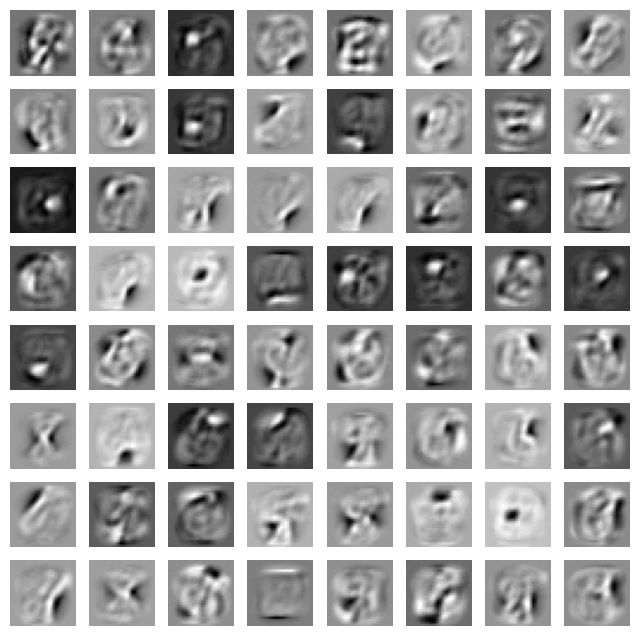

In [99]:
# 重みを画像として表示
W = rbm.W.detach().cpu().numpy()

fig, axes = plt.subplots(8, 8, figsize=(8, 8))
for i, ax in enumerate(axes.flat):
    if i < hidden_units:
        # 重みベクトルを画像に変形
        image = W[:, i].reshape(28, 28)
        ax.imshow(image, cmap='gray')
        ax.axis('off')
plt.show()

再構成画像の表示

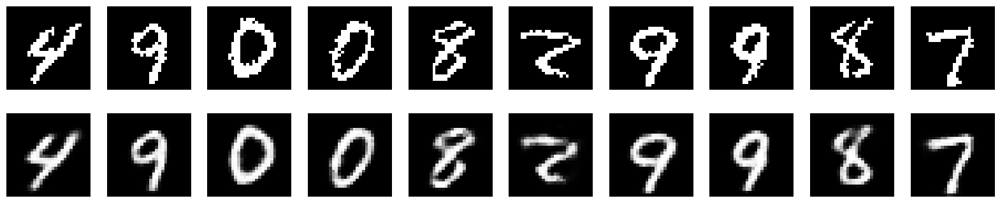

In [86]:
# テストデータの準備
test_data = datasets.MNIST(root='./data', train=False, download=True, transform=transform)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=10, shuffle=True)

# テストデータからバッチを取得
test_batch, _ = next(iter(test_loader))
test_batch = test_batch.view(-1, visible_units)

# 入力データをRBMに通す
v, _ = rbm.sample_h(test_batch)
reconstructed_v, _ = rbm.sample_v(v)

# 元の画像と再構成された画像を表示
plt.figure(figsize=(20, 4))
for i in range(10):
    # 元の画像
    ax = plt.subplot(2, 10, i + 1)
    plt.imshow(test_batch[i].view(28, 28), cmap='gray')
    ax.axis('off')

    # 再構成された画像
    ax = plt.subplot(2, 10, i + 11)
    plt.imshow(reconstructed_v[i].view(28, 28).detach(), cmap='gray')
    ax.axis('off')
plt.show()

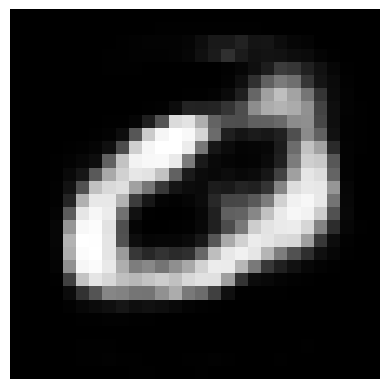

In [105]:
# 隠れユニットにランダムな値を与える
h = torch.bernoulli(torch.rand(1, hidden_units))

# サンプリングの反復回数
num_steps = 1000

for _ in range(num_steps):
    v_prob, v = rbm.sample_v(h)
    h_prob, h = rbm.sample_h(v)

# 最終的な可視ユニットを取得
generated_v = v_prob

# 生成された画像を表示
plt.imshow(generated_v.view(28, 28).detach(), cmap='gray')
plt.axis('off')
plt.show()


## ■深層学習へ
この制限付きボルツマンマシンは、入力データセットの確率分布を、隠れノードを持った複雑な確率分布（イジング模型の熱平衡状態）で学習をしています。このとき、隠れノードの数を、可視ノードの数よりも小さく設定しておくと、ある種の情報の圧縮を行うことができます。可視ノードの情報を再現できるように、情報を圧縮することで、隠れノードには入力データの **特徴** が表現されるようになります。つまり、特徴量の学習を行うことができます。それ以前の、ニューラルネットワークは、データからどのような特徴量を得てネットワークに入力するか、人間が試行錯誤でデザインしていました。しかし、この特徴量学習によってこのプロセスが自動化されニューラルネットワークの応用の範囲が広がりました。また、制限付きボルツマンマシンで、再構成をさせる形で学習させたネットワークを多層で繋げる（深層信念ネットワーク）ことで、多層ニューラルネットワークにおける学習の難しさ（勾配消失）も回避できるようになり、現在につながるディープニューラルネットワーク（深層学習）へと発展していきました。